In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [2]:
import pandas as pd
pd.set_option('display.max_rows', 500)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
color_pal = sns.color_palette()
import plotly.graph_objects as go
import plotly.express as px
import xgboost as xgb
from sklearn.metrics import mean_squared_error
import scipy.stats as stats
from IPython.display import display, HTML

In [3]:
# Function to create scrollable table within a small window
def create_scrollable_table(df, table_id, title):
    html = f'<h3>{title}</h3>'
    html += f'<div id="{table_id}" style="height:200px; overflow:auto;">'
    html += df.to_html()
    html += '</div>'
    return html

# Basic Data Exploration

1. Loading Data
2. Inspecting Data
3. Handling Missing Data
4. Data Cleaning
5. Exploring Target Variable
6. Visualizing Data
7. Feature Relationships
8. Categorical Variables
9. Grouping and Aggregating Data
10. Feature Engineering
11. Outliers Detection
12. Data Splits
13. Statistical Tests
14. Domain Knowledge

In [4]:
# import data 
df = pd.read_csv('train.csv', delimiter=',')

In [5]:
df.shape

(61244, 5)

In [6]:
df.dtypes

Datum                      object
Lokalzeit                  object
Last [kW]                 float64
Globalstrahlung [W/m2]    float64
Lufttemperatur [°C]       float64
dtype: object

In [7]:
df.head()

,Datum,Lokalzeit,Last [kW],Globalstrahlung [W/m2],Lufttemperatur [°C]
0,01.01.2021,00:15:00,53403.20,0.0,-0.7
1,01.01.2021,00:30:00,52923.44,0.0,-0.7
2,01.01.2021,00:45:00,52569.89,0.0,-0.7
3,01.01.2021,01:00:00,51653.21,0.0,-0.7
4,01.01.2021,01:15:00,50883.41,0.0,-0.4


In [8]:
df['Timestamp'] = pd.to_datetime(df['Datum'] + ' ' + df['Lokalzeit'], format="%d.%m.%Y %H:%M:%S")

In [9]:
df = df.set_index('Timestamp')

In [10]:
df.rename(columns=lambda x: x.replace(' [W/m2]', ''), inplace=True)
df.rename(columns=lambda x: x.replace(' [°C]', ''), inplace=True)
df.rename(columns=lambda x: x.replace(' [kW]', ''), inplace=True)

In [11]:
# Summary statistics for numerical features
numerical_features = df.select_dtypes(include=[np.number])
summary_stats = numerical_features.describe().T
html_numerical = create_scrollable_table(summary_stats, 'numerical_features', 'Summary statistics for numerical features')

display(HTML(html_numerical))

,count,mean,std,min,25%,50%,75%,max
Last,61244.0,39608.778962,10952.393694,17199.6,30848.6475,38073.055,47281.5975,72525.98
Globalstrahlung,61244.0,141.497139,219.254210,0.0,0.0000,8.300,213.9000,977.80
Lufttemperatur,61244.0,11.345885,8.277447,-12.7,4.5000,11.300,17.2000,35.80


In [12]:
# Summary statistics for categorical features
categorical_features = df.select_dtypes(include=[object])
cat_summary_stats = categorical_features.describe().T
html_categorical = create_scrollable_table(cat_summary_stats, 'categorical_features', 'Summary statistics for categorical features')

display(HTML(html_categorical ))

,count,unique,top,freq
Datum,61244,639,31.10.2021,100
Lokalzeit,61244,96,00:15:00,638


In [13]:
# Null values in the dataset
null_values = df.isnull().sum()
html_null_values = create_scrollable_table(null_values.to_frame(), 'null_values', 'Null values in the dataset')

# Percentage of missing values for each feature
missing_percentage = (df.isnull().sum() / len(df)) * 100
html_missing_percentage = create_scrollable_table(missing_percentage.to_frame(), 'missing_percentage', 'Percentage of missing values for each feature')

display(HTML(html_null_values + html_missing_percentage))

,0
Datum,0
Lokalzeit,0
Last,0
Globalstrahlung,0
Lufttemperatur,0
,0
Datum,0.0
Lokalzeit,0.0
Last,0.0
Globalstrahlung,0.0


In [14]:
# Exploring rows with missing values
rows_with_missing_values = df[df.isnull().any(axis=1)]
html_rows_with_missing_values = create_scrollable_table(rows_with_missing_values.head(), 'rows_with_missing_values', 'Rows with missing values')

display(HTML(html_rows_with_missing_values))

,Datum,Lokalzeit,Last,Globalstrahlung,Lufttemperatur
Timestamp,,,,,


# Feature engineering
1. Generate additional features (e.g. month, day of the week, quarter-hour, public-holidays)
2. Visualize Feature / Target Relationship

### Generate additional features (e.g. month, day of the week, quarter-hour, public-holidays)

In [15]:
def create_features(df):
    # Create time series features based on the time series index
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['quarter_hour'] = ((df.index.hour * 60 + df.index.minute) /15).astype(int)
    # public holidays
    public_holidays = ['01.01.2021', '02.01.2021', '02.04.2021', '05.04.2021', '01.05.2021', '13.05.2021', \
                       '24.05.2021', '01.08.2021', '19.09.2021', '25.12.2021', '26.12.2021' \
                       '01.01.2022', '02.01.2022', '15.04.2022', '18.04.2022', '01.05.2022', '26.05.2022', \
                       '06.06.2022', '01.08.2022', '18.09.2022', '25.12.2022', '26.12.2022' \
                       '01.01.2023', '02.01.2023', '07.04.2023', '10.04.2023', '01.05.2023', '18.05.2023', \
                       '29.05.2023', '01.08.2023', '17.09.2021', '25.12.2023', '26.12.2023' \
                       ]
    df['public_holiday'] = df.Datum.isin(public_holidays)
    # holidays
    holidays = [ 
        {
            "name": "Weihnachtsferien 2021",
            "start_date": "01.01.2021",
            "end_date": "03.01.2021"
        },
        {
            "name": "Frühlingsferien 2021",
            "start_date": "02.04.2021",
            "end_date": "18.04.2021"
        },
        {
            "name": "Sommerferien 2021",
            "start_date": "12.07.2021",
            "end_date": "15.08.2021"
        },
        {
            "name": "Herbstferien 2021",
            "start_date": "11.10.2021",
            "end_date": "24.10.2021"
        },
        {
            "name": "Weihnachtsferien 2021",
            "start_date": "20.12.2021",
            "end_date": "02.01.2022"
        },
        {
            "name": "Frühlingsferien 2022",
            "start_date": "04.04.2022",
            "end_date": "18.04.2022"
        },
        {
            "name": "Sommerferien 2022",
            "start_date": "11.07.2022",
            "end_date": "14.08.2022"
        },
        {
            "name": "Herbstferien 2022",
            "start_date": "10.10.2022",
            "end_date": "23.10.2022"
        },
        {
            "name": "Weihnachtsferien 2022",
            "start_date": "26.12.2022",
            "end_date": "08.01.2023"
        },
        {
            "name": "Frühlingsferien 2023",
            "start_date": "27.03.2023",
            "end_date": "10.04.2023"
        },
        {
            "name": "Sommerferien 2023",
            "start_date": "10.07.2023",
            "end_date": "13.08.2023"
        }
        
    ]
    df['holidays'] = False
    for holiday in holidays:
        start = pd.to_datetime(holiday["start_date"], format="%d.%m.%Y")
        end = pd.to_datetime(holiday["end_date"], format="%d.%m.%Y")
        df.loc[(df.index >= start) & (df.index <= end), 'holidays'] = True
    return df

df = create_features(df)

In [16]:
df = df.drop(['Datum', 'Lokalzeit'], axis=1)

In [17]:
df.head()

,Last,Globalstrahlung,Lufttemperatur,hour,dayofweek,quarter,month,year,dayofyear,quarter_hour,public_holiday,holidays
Timestamp,,,,,,,,,,,,
2021-01-01 00:15:00,53403.20,0.0,-0.7,0,4,1,1,2021,1,1,True,True
2021-01-01 00:30:00,52923.44,0.0,-0.7,0,4,1,1,2021,1,2,True,True
2021-01-01 00:45:00,52569.89,0.0,-0.7,0,4,1,1,2021,1,3,True,True
2021-01-01 01:00:00,51653.21,0.0,-0.7,1,4,1,1,2021,1,4,True,True
2021-01-01 01:15:00,50883.41,0.0,-0.4,1,4,1,1,2021,1,5,True,True


In [18]:
# Summary statistics for numerical features
numerical_features = df.select_dtypes(include=[np.number])
summary_stats = numerical_features.describe().T
html_numerical = create_scrollable_table(summary_stats, 'numerical_features', 'Summary statistics for numerical features')

display(HTML(html_numerical))

,count,mean,std,min,25%,50%,75%,max
Last,61244.0,39608.778962,10952.393694,17199.6,30848.6475,38073.055,47281.5975,72525.98
Globalstrahlung,61244.0,141.497139,219.254210,0.0,0.0000,8.300,213.9000,977.80
Lufttemperatur,61244.0,11.345885,8.277447,-12.7,4.5000,11.300,17.2000,35.80
hour,61244.0,11.500604,6.922065,0.0,6.0000,12.000,18.0000,23.00
dayofweek,61244.0,3.001388,1.998770,0.0,1.0000,3.000,5.0000,6.00
quarter,61244.0,2.295000,1.029846,1.0,1.0000,2.000,3.0000,4.00
month,61244.0,5.881670,3.194191,1.0,3.0000,6.000,8.0000,12.00
year,61244.0,2021.427879,0.494775,2021.0,2021.0000,2021.000,2022.0000,2022.00
dayofyear,61244.0,163.340295,97.611828,1.0,80.0000,160.000,240.0000,365.00
quarter_hour,61244.0,47.502417,27.710826,0.0,24.0000,48.000,72.0000,95.00


In [19]:
# Summary statistics for categorical features -> no categorical features
categorical_features = df.select_dtypes(include=['object', 'bool'])
cat_summary_stats = categorical_features.describe().T
html_categorical = create_scrollable_table(cat_summary_stats, 'categorical_features', 'Summary statistics for categorical features')

display(HTML(html_categorical ))

,count,unique,top,freq
public_holiday,61244,2,False,59421
holidays,61244,2,False,49142


### Visualize Feature / Target Relationship

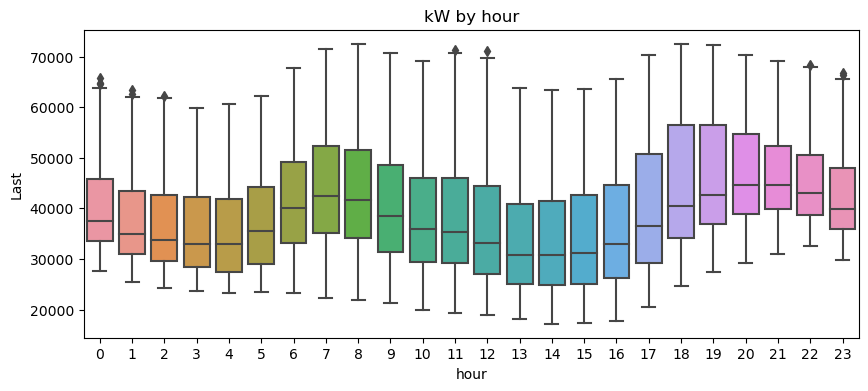

In [20]:
fig, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(data=df, x='hour', y='Last')
ax.set_title('kW by hour')
plt.show()

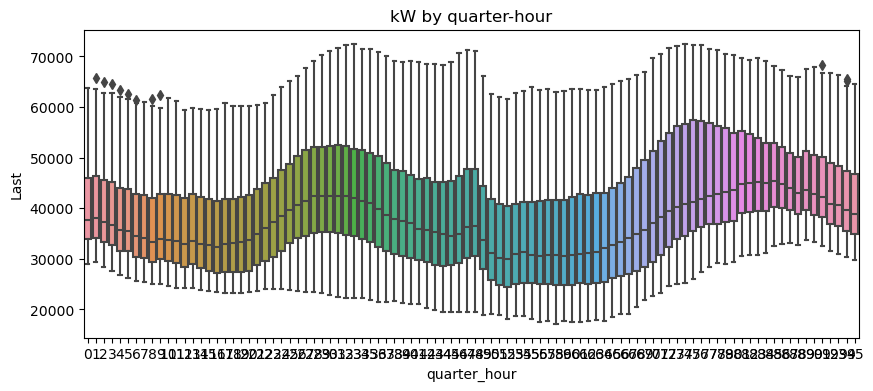

In [21]:
fig, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(data=df, x='quarter_hour', y='Last')
ax.set_title('kW by quarter-hour')
plt.show()

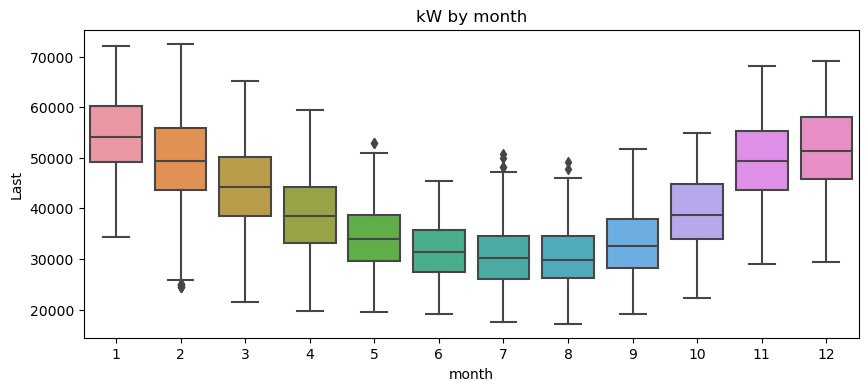

In [22]:
fig, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(data=df, x='month', y='Last')
ax.set_title('kW by month')
plt.show()

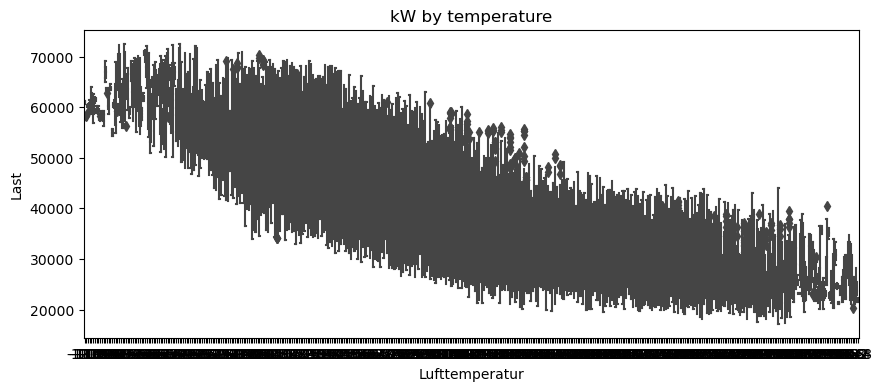

In [23]:
fig, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(data=df, x='Lufttemperatur', y='Last')
ax.set_title('kW by temperature')
plt.show()

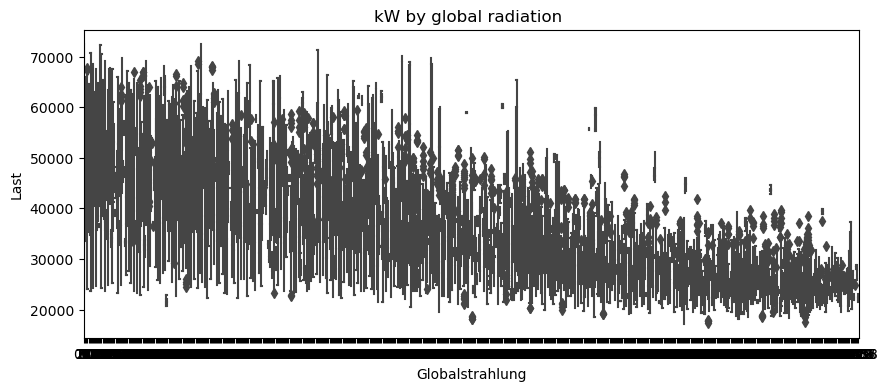

In [24]:
fig, ax = plt.subplots(figsize=(10, 4))
sns.boxplot(data=df, x='Globalstrahlung', y='Last')
ax.set_title('kW by global radiation ')
plt.show()

### Exploring Target Variable

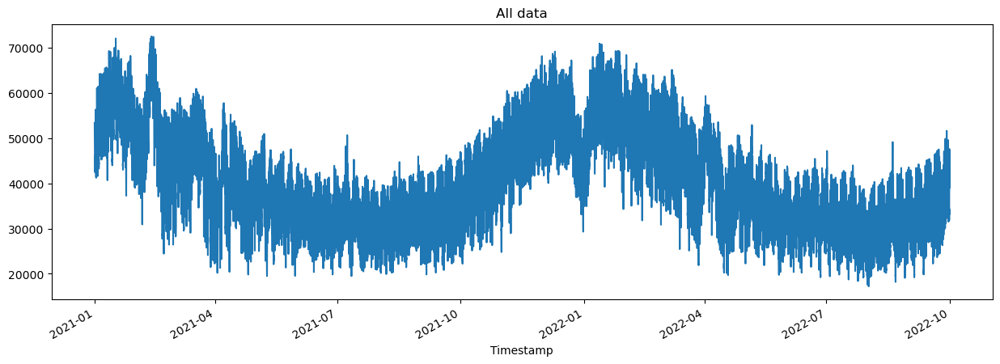

In [25]:
df['Last'].plot(style='-', figsize=(15,5), color=color_pal[0], title='All data')
plt.show()

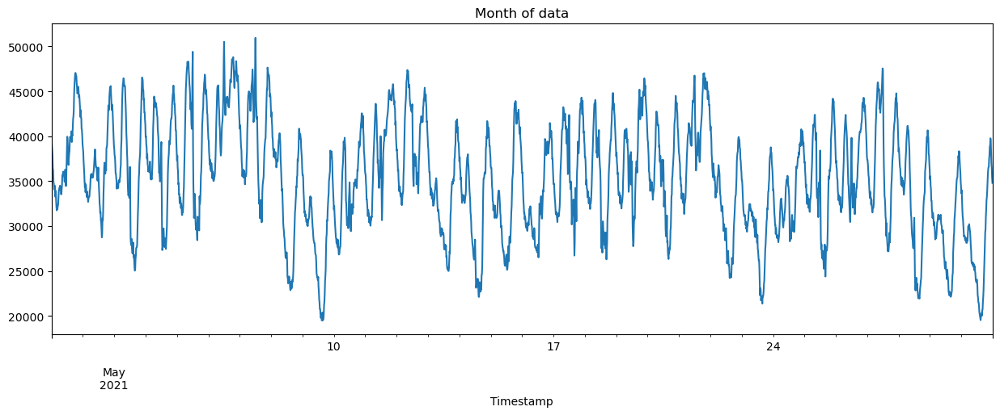

In [26]:
df['Last'].loc[(df.index > '2021-05-01') & (df.index < '2021-05-31')].plot(figsize=(15, 5), title='Month of data')
plt.show()

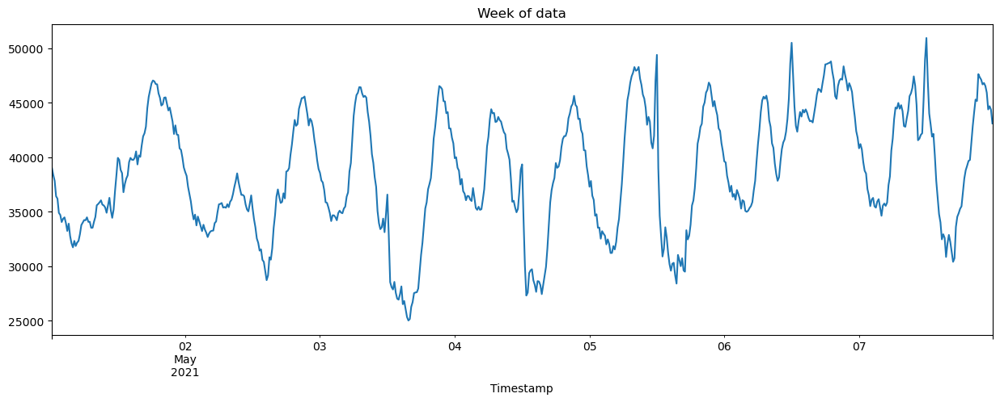

In [27]:
df['Last'].loc[(df.index > '2021-05-01') & (df.index < '2021-05-08')].plot(figsize=(15, 5), title='Week of data')
plt.show()

In [ ]:
import scipy.stats as stats

# Fit a normal distribution to the load data
mu, sigma = stats.norm.fit(df['Last'])

# Create a histogram of the load column
hist_data = go.Histogram(x=df['Last'], nbinsx=50, name="Histogram", opacity=0.75, histnorm='probability density', marker=dict(color='purple'))

# Calculate the normal distribution based on the fitted parameters
x_norm = np.linspace(df['Last'].min(), df['Last'].max(), 100)
y_norm = stats.norm.pdf(x_norm, mu, sigma)

# Create the normal distribution overlay
norm_data = go.Scatter(x=x_norm, y=y_norm, mode="lines", name=f"Normal dist. (μ={mu:.2f}, σ={sigma:.2f})", line=dict(color="green"))

# Combine the histogram and the overlay
fig = go.Figure(data=[hist_data, norm_data])

# Set the layout for the plot
fig.update_layout(
    title="Load Distribution",
    xaxis_title="Last",
    yaxis_title="Density",
    legend_title_text="Fitted Normal Distribution",
    plot_bgcolor='rgba(32, 32, 32, 1)',
    paper_bgcolor='rgba(32, 32, 32, 1)',
    font=dict(color='white')
)

# Create a Q-Q plot
qq_data = stats.probplot(df['Last'], dist="norm")
qq_fig = px.scatter(x=qq_data[0][0], y=qq_data[0][1], labels={'x': 'Theoretical Quantiles', 'y': 'Ordered Values'}, color_discrete_sequence=["purple"])
qq_fig.update_layout(
    title="Q-Q plot",
    plot_bgcolor='rgba(32, 32, 32, 1)',
    paper_bgcolor='rgba(32, 32, 32, 1)',
    font=dict(color='white')
)

# Calculate the line of best fit
slope, intercept, r_value, p_value, std_err = stats.linregress(qq_data[0][0], qq_data[0][1])
line_x = np.array(qq_data[0][0])
line_y = intercept + slope * line_x

# Add the line of best fit to the Q-Q plot
line_data = go.Scatter(x=line_x, y=line_y, mode="lines", name="Normal Line", line=dict(color="green"))

# Update the Q-Q plot with the normal line
qq_fig.add_trace(line_data)

# Show the plots
fig.show()
qq_fig.show()

#notebook credit: https://www.kaggle.com/code/serigne/stacked-regressions-top-4-on-leaderboard

In [29]:
# 7. Box plot of load over the years
yearly_avg_load = df.groupby('year')['Last'].mean()

fig13 = px.box(df, x='year', y='Last', title='Load Trends Over the Years',
               points=False, color_discrete_sequence=['green'])

fig13.add_trace(px.line(x=yearly_avg_load.index, y=yearly_avg_load.values).data[0])

fig13.update_traces(line=dict(color='purple', width=4), selector=dict(type='scatter', mode='lines'))

for year, avg_price in yearly_avg_load.items():
    fig13.add_annotation(
        x=year,
        y=avg_price,
        text=f"{avg_price:,.0f}",
        font=dict(color='white'),
        showarrow=False,
        bgcolor='rgba(128, 0, 128, 0.6)'
    )

fig13.update_layout(
    plot_bgcolor='rgb(30,30,30)',
    paper_bgcolor='rgb(30,30,30)',
    font=dict(color='white'),
    xaxis_title='Year',
    yaxis_title='Load'
)

fig13.show()

# Creating a Data Pipeline
Improves readability and makes further changes in features and transformations more easy

In [30]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder


# Define transformers for numerical and categorical columns
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
    ('onehot', OneHotEncoder(handle_unknown='ignore', sparse = False))
])


In [31]:
# Update categorical and numerical columns
categorical_columns = df.select_dtypes(include=['object', 'category']).columns
numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns

# Remove target variable from numerical columns
numerical_columns = numerical_columns.drop('Last')

# Combine transformers using ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_columns),
        ('cat', categorical_transformer, categorical_columns)
    ],remainder = 'passthrough')

# Create a pipeline with the preprocessor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor)])

# Apply the pipeline to your dataset
X = df.drop('Last', axis=1)
y = np.log(df['Last']) #normalize dependent variable 
X_preprocessed = pipeline.fit_transform(X)

# Fit and parameter tune model

In this use-case we tune 4 models and use the one with best performance

1. Linear Regression
2. Random Forest
3. XGBoost
4. MLP Regressor


In [32]:
# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_preprocessed, y, test_size=0.2, random_state=42)

In [33]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV, KFold, cross_val_score

# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_preprocessed, y, test_size=0.2, random_state=42)

# Define the models
models = {
    'LinearRegression': LinearRegression(),
    'RandomForest': RandomForestRegressor(random_state=42),
    'XGBoost': XGBRegressor(random_state=42)
}

# Define the hyperparameter grids for each model
param_grids = {
    'LinearRegression': {},
    'RandomForest': {
        'n_estimators': [100, 200, 500],
        'max_depth': [None, 10, 30],
        'min_samples_split': [2, 5, 10],
    },
    'XGBoost': {
        'n_estimators': [100, 200, 500],
        'learning_rate': [0.01, 0.1, 0.3],
        'max_depth': [3, 6, 10],
    }
}

# 3-fold cross-validation
cv = KFold(n_splits=3, shuffle=True, random_state=42)

# Train and tune the models
grids = {}
for model_name, model in models.items():
    #print(f'Training and tuning {model_name}...')
    grids[model_name] = GridSearchCV(estimator=model, param_grid=param_grids[model_name], cv=cv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=2)
    grids[model_name].fit(X_train, y_train)
    best_params = grids[model_name].best_params_
    best_score = np.sqrt(-1 * grids[model_name].best_score_)
    
    print(f'Best parameters for {model_name}: {best_params}')
    print(f'Best RMSE for {model_name}: {best_score}\n')

Fitting 3 folds for each of 1 candidates, totalling 3 fits
Best parameters for LinearRegression: {}
Best RMSE for LinearRegression: 0.13416410355428982

Fitting 3 folds for each of 27 candidates, totalling 81 fits
[CV] END .................................................... total time=   0.0s
[CV] END max_depth=None, min_samples_split=2, n_estimators=200; total time=  42.7s


/Users/stefanfrei/anaconda3/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



[CV] END .................................................... total time=   0.0s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=  21.1s
[CV] END max_depth=None, min_samples_split=2, n_estimators=500; total time= 1.7min
[CV] END .................................................... total time=   0.0s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=  21.2s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=  18.6s
[CV] END max_depth=None, min_samples_split=5, n_estimators=100; total time=  18.8s
[CV] END max_depth=None, min_samples_split=5, n_estimators=500; total time= 1.5min
[CV] END max_depth=None, min_samples_split=10, n_estimators=500; total time= 1.2min
[CV] END max_depth=10, min_samples_split=5, n_estimators=500; total time=  37.6s
[CV] END max_depth=30, min_samples_split=2, n_estimators=200; total time=  25.5s
[CV] END max_depth=None, min_samples_split=2, n_estimators=100; total time=  21.1s
[CV] END ma

In [34]:
from sklearn.neural_network import MLPRegressor

X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

# Create an MLPRegressor instance
mlp = MLPRegressor(random_state=42,max_iter=10000, n_iter_no_change = 3,learning_rate_init=0.001)

# Define the parameter grid for tuning
param_grid = {
    'hidden_layer_sizes': [(10,), (10,10), (10,10,10), (25)],
    'activation': ['relu', 'tanh'],
    'solver': ['adam'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'invscaling', 'adaptive'],
}

# Create the GridSearchCV object
grid_search_mlp = GridSearchCV(mlp, param_grid, scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit the model on the training data
grid_search_mlp.fit(X_train_scaled, y_train)

# Print the best parameters found during the search
print("Best parameters found: ", grid_search_mlp.best_params_)

# Evaluate the model on the test data
best_score = np.sqrt(-1 * grid_search_mlp.best_score_)
print("Test score: ", best_score)

Fitting 3 folds for each of 72 candidates, totalling 216 fits
Best parameters found:  {'activation': 'relu', 'alpha': 0.01, 'hidden_layer_sizes': 25, 'learning_rate': 'constant', 'solver': 'adam'}
Test score:  0.08440179227254133
[CV] END max_depth=30, min_samples_split=10, n_estimators=500; total time=  42.5s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   5.1s
[CV] END .learning_rate=0.01, max_depth=10, n_estimators=100; total time=   1.6s
[CV] END .learning_rate=0.01, max_depth=10, n_estimators=200; total time=   4.6s
[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=100; total time=   1.3s
[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=200; total time=   2.7s
[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=500; total time=   7.3s
[CV] END ...learning_rate=0.1, max_depth=6, n_estimators=200; total time=   7.0s
[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=100; total time=   6.5s
[CV] END ..learning_rate=0.1, max_depth=

[CV] END max_depth=30, min_samples_split=5, n_estimators=200; total time=  23.2s
[CV] END max_depth=30, min_samples_split=10, n_estimators=100; total time=  10.6s
[CV] END max_depth=30, min_samples_split=10, n_estimators=200; total time=  21.0s
[CV] END max_depth=30, min_samples_split=10, n_estimators=500; total time=  41.2s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   1.0s
[CV] END ..learning_rate=0.01, max_depth=6, n_estimators=100; total time=   1.5s
[CV] END ..learning_rate=0.01, max_depth=6, n_estimators=500; total time=  11.7s
[CV] END ...learning_rate=0.1, max_depth=3, n_estimators=200; total time=   2.9s
[CV] END ...learning_rate=0.1, max_depth=6, n_estimators=100; total time=   3.1s
[CV] END ...learning_rate=0.1, max_depth=6, n_estimators=100; total time=   3.2s
[CV] END ...learning_rate=0.1, max_depth=6, n_estimators=500; total time=  18.8s
[CV] END ..learning_rate=0.1, max_depth=10, n_estimators=500; total time=  38.3s
[CV] END ..learning_rate=

### Feature Importance

In [35]:
# feature importances of the best XGBoost model
best_xgb_model = grids['XGBoost'].best_estimator_
feature_importances = best_xgb_model.feature_importances_

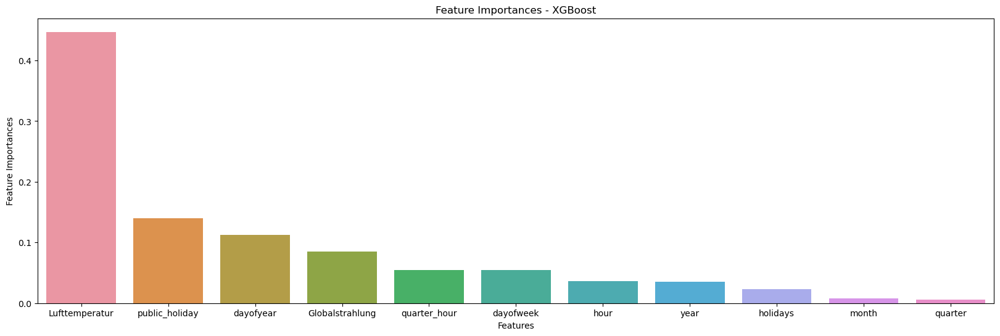

In [36]:
# Assuming you have a DataFrame 'df_importances' with 'features' and 'importances' columns
# and feature_importances obtained from the XGBoost model
features = df.columns[1:]
df_importances = pd.DataFrame({'features': features, 'importances': feature_importances})
plt.figure(figsize=(20, 6))
sns.barplot(x='features', y='importances', data=df_importances.sort_values('importances', ascending=False))
plt.xlabel('Features')
plt.ylabel('Feature Importances')
plt.title('Feature Importances - XGBoost')
plt.xticks(rotation=0)
plt.show()

### Model quality in training data

In [37]:
y_xgboost = np.exp(grids['XGBoost'].predict(X_preprocessed))
df['Forecast'] = y_xgboost
df['fc_error'] = np.abs(df['Forecast'] - df['Last'])

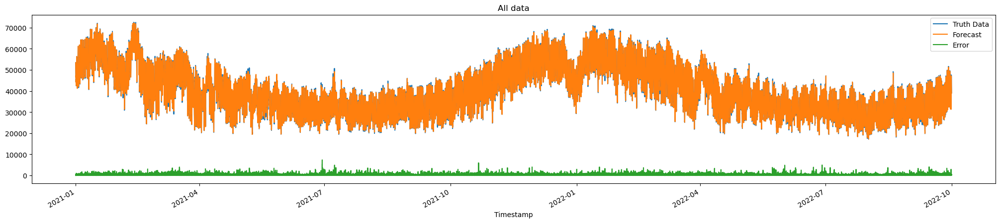

In [38]:
ax = df[['Last']].plot(figsize=(25, 5))
df['Forecast'].plot(ax=ax, style='-')
df['fc_error'].plot(ax=ax, style='-')
plt.legend(['Truth Data', 'Forecast', 'Error'])
ax.set_title('All data')
plt.show()

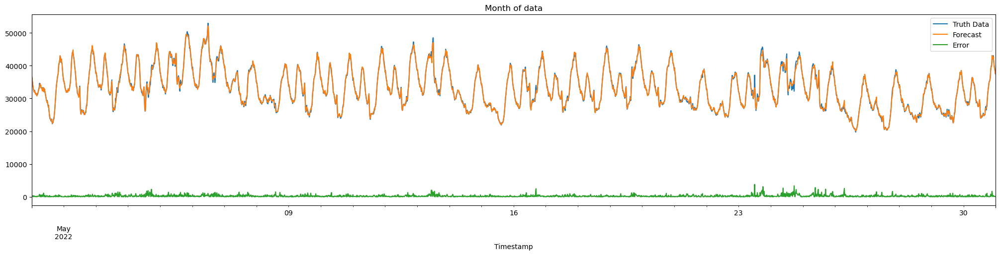

In [39]:
ax = df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-31')]['Last'] \
    .plot(figsize=(25, 5), title='Month of data')
df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-31')]['Forecast'] \
    .plot(style='-')
df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-31')]['fc_error'] \
    .plot(style='-')
plt.legend(['Truth Data', 'Forecast', 'Error'])
plt.show()

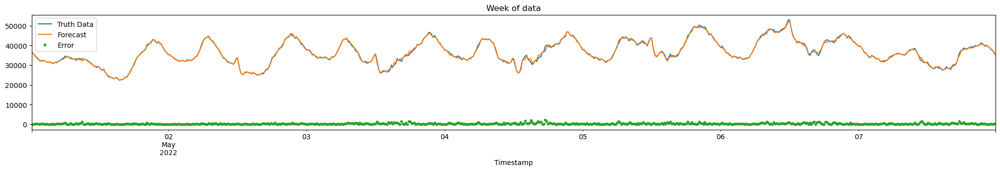

In [40]:
ax = df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-08')]['Last'] \
    .plot(figsize=(25, 3), title='Week of data')
df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-08')]['Forecast'] \
    .plot(style='-')
df.loc[(df.index > '2022-05-01') & (df.index < '2022-05-08')]['fc_error'] \
    .plot(style='.')
plt.legend(['Truth Data', 'Forecast', 'Error'])
plt.show()

# Test the model on most recent data (validation data, not used in the modelling process above!)

### Import and format validation data

In [41]:
df_test = pd.read_csv('test.csv', delimiter=',')

In [42]:
df_test['Timestamp'] = pd.to_datetime(df_test['Datum'] + ' ' + df_test['Lokalzeit'], format="%d.%m.%Y %H:%M:%S")

In [43]:
df_test = df_test.set_index('Timestamp')

In [44]:
df_test.rename(columns=lambda x: x.replace(' [W/m2]', ''), inplace=True)
df_test.rename(columns=lambda x: x.replace(' [°C]', ''), inplace=True)
df_test.rename(columns=lambda x: x.replace(' [kW]', ''), inplace=True)

In [45]:
df_test = create_features(df_test)

In [46]:
df_test = df_test.drop(['Datum', 'Lokalzeit'], axis=1)

### Forecast on validation data

1. preprocess validation data
2. predict forecast with best XGBoost model


In [47]:
df_test_preprocessed = pipeline.transform(df_test)

In [48]:
y_xgboost_test = np.exp(grids['XGBoost'].predict(df_test_preprocessed))
df_test['Forecast'] = y_xgboost_test

### Model quality in training data

In [49]:
df_test['fc_error'] = np.abs(df_test['Forecast'] - df_test['Last'])

In [50]:
mse = mean_squared_error(df_test['Last'], df_test['Forecast'])

In [51]:
print(np.sqrt(mse)/70080)

0.04944738153907702


In [52]:
df_test.fc_error.sort_values(ascending=False).head(20)

Timestamp
2022-12-13 10:45:00    11862.880312
2022-12-13 11:00:00    11720.211250
2022-12-13 10:00:00    11644.192500
2022-12-13 10:30:00    11548.745938
2022-12-13 09:45:00    11363.180938
2022-11-23 13:30:00    11208.571094
2022-11-19 10:30:00    11148.649844
2022-11-19 10:45:00    10978.005000
2022-11-17 09:00:00    10943.072500
2022-11-23 13:45:00    10825.148438
2022-11-19 10:15:00    10821.379531
2022-11-19 11:00:00    10703.215469
2022-12-13 10:15:00    10514.944062
2022-11-23 13:15:00    10500.463750
2022-12-13 09:30:00    10363.384531
2022-11-23 09:00:00    10327.857344
2022-11-23 14:00:00    10295.184062
2022-11-26 10:30:00    10282.028906
2022-11-05 11:00:00    10242.635938
2022-11-26 12:00:00    10182.705469
Name: fc_error, dtype: float64

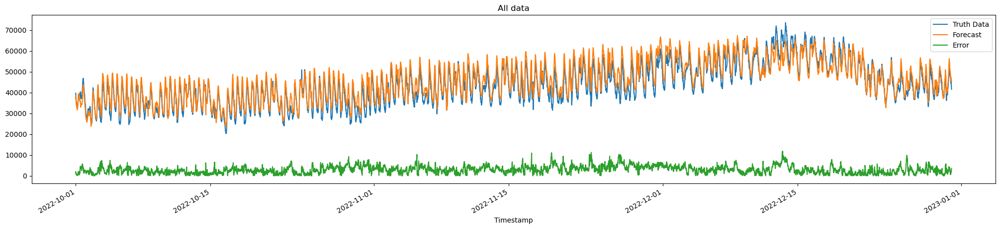

In [53]:
ax = df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-12-31')]['Last'] \
    .plot(figsize=(25, 5), title='All data')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-12-31')]['Forecast'] \
    .plot(style='-')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-12-31')]['fc_error'] \
    .plot(style='-')
plt.legend(['Truth Data', 'Forecast', 'Error'])
plt.show()

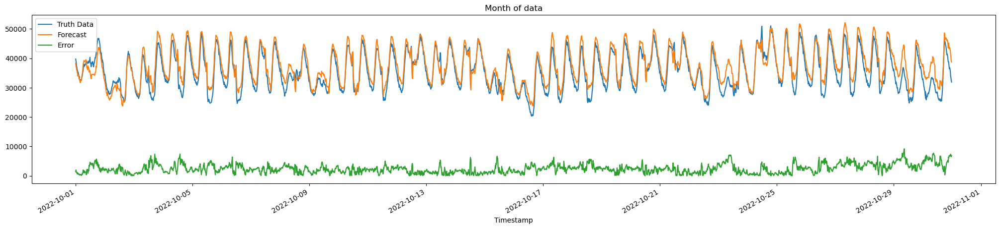

In [54]:
ax = df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-31')]['Last'] \
    .plot(figsize=(25, 5), title='Month of data')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-31')]['Forecast'] \
    .plot(style='-')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-31')]['fc_error'] \
    .plot(style='-')
plt.legend(['Truth Data', 'Forecast', 'Error'])
plt.show()

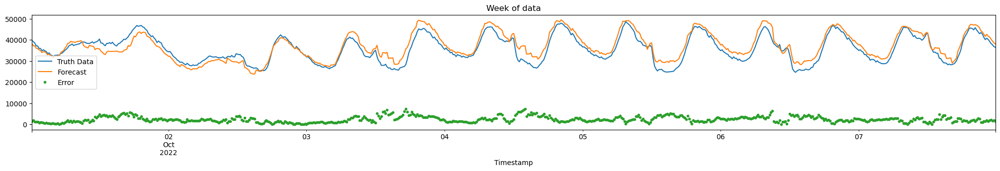

In [55]:
ax = df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-08')]['Last'] \
    .plot(figsize=(25, 3), title='Week of data')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-08')]['Forecast'] \
    .plot(style='-')
df_test.loc[(df_test.index > '2022-10-01') & (df_test.index < '2022-10-08')]['fc_error'] \
    .plot(style='.')
plt.legend(['Truth Data', 'Forecast', 'Error'])
plt.show()